<a href="https://colab.research.google.com/github/Rustam86/HSE-course-project/blob/main/analyses_examples__.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import warnings
warnings.filterwarnings('ignore')
import os
import glob
import re
import gdown
import json
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
from pandas.api.types import CategoricalDtype

In [ ]:
url = 'https://drive.google.com/uc?id=1Xh9XXQbRTjZniGMCZI9TVzUf_B9Xh7g8'
output = 'SARS-CoV-2-6.5M-pango-labels.csv'
gdown.download(url, output, quiet=False)

In [ ]:
!apt-get install -y subversion

In [ ]:
!wget https://raw.githubusercontent.com/Rustam86/HSE-course-project/main/requirements.txt
!wget https://raw.githubusercontent.com/Rustam86/HSE-course-project/main/coronavirus_sequence_analysis.py
!wget https://raw.githubusercontent.com/Rustam86/HSE-course-project/main/zhunt3-alan.c
!svn export --force https://github.com/Rustam86/HSE-course-project/trunk/Coronaviridae%20strains_ZHUNT_predictions
!svn export --force https://github.com/Rustam86/HSE-course-project/trunk/Coronaviridae%20strains_DNABERT_predictions
!svn export --force https://github.com/Rustam86/HSE-course-project/trunk/Coronaviridae%20strains%20META%20DNABERT
!svn export --force https://github.com/Rustam86/HSE-course-project/trunk/Coronaviridae%20strains%20META%20ZHUNT

In [ ]:
!pip install -r /content/requirements.txt

In [7]:
from coronavirus_sequence_analysis import *

In [8]:
plt.rcParams["figure.dpi"] = 600

In [ ]:
!gcc zhunt3-alan.c -lm -o zhunt3

In [10]:
!chmod +x /content/zhunt3

In [11]:
dir_list_zhunt = os.listdir("/content/Coronaviridae strains META ZHUNT")
dir_list_zdnabert = os.listdir("/content/Coronaviridae strains META DNABERT")

In [12]:
with open('all_taxa_meta_zhunt.csv', 'w') as all_taxa_meta:
  for name, meta in zip(sorted(list(VIRUS_TAXA_SPECIES.keys())), sorted(dir_list_zhunt)):
    meta = f"/content/Coronaviridae strains META ZHUNT/{meta}"
    with open(meta, 'r') as vm:
      taxa = VIRUS_TAXA_SPECIES[name][1]
      species = VIRUS_TAXA_SPECIES[name][0]
      for line in vm.readlines()[1:]:
        all_taxa_meta.write(f'{species},{taxa},{name},{line}')

In [13]:
with open('all_taxa_meta_zdnabert.csv', 'w') as all_taxa_meta:
  for name, meta in zip(sorted(list(VIRUS_TAXA_SPECIES.keys())), sorted(dir_list_zdnabert)):
    meta = f"/content/Coronaviridae strains META DNABERT/{meta}"
    with open(meta, 'r') as vm:
      taxa = VIRUS_TAXA_SPECIES[name][1]
      species = VIRUS_TAXA_SPECIES[name][0]
      for line in vm.readlines()[1:]:
        all_taxa_meta.write(f'{species},{taxa},{name},{line}')

In [14]:
cols = ['species', 'taxa', 'name', 'wtf', 'GenBank ID', 'Accession', 'Description',
       'Collection Date', 'Geographic Location', 'Sequence Length', 'Host',
       'Intervals Total Length', 'Intervals Mean Length']

In [15]:
all_taxa_zdnabert = pd.read_csv('/content/all_taxa_meta_zdnabert.csv', names=cols)
all_taxa_zhunt = pd.read_csv('/content/all_taxa_meta_zhunt.csv', names=cols)

In [16]:
all_taxa_zdnabert['Total Length normalized'] = np.array(all_taxa_zdnabert['Intervals Total Length']) / np.array(all_taxa_zdnabert['Sequence Length'])
all_taxa_zdnabert['Mean length normalized'] = np.array(all_taxa_zdnabert['Intervals Mean Length']) / np.array(all_taxa_zdnabert['Sequence Length'])

In [17]:
all_taxa_zhunt['Total Length normalized'] = np.array(all_taxa_zhunt['Intervals Total Length']) / np.array(all_taxa_zhunt['Sequence Length'])
all_taxa_zhunt['Mean length normalized'] = np.array(all_taxa_zhunt['Intervals Mean Length']) / np.array(all_taxa_zhunt['Sequence Length'])

In [18]:
draw_boxplot_species(all_taxa_zdnabert, value_label='Intervals Total Length', plot_title="Intervals Total Length (ZDANBERT)", figure_size=(20, 8), text_position=(0.009, 0.48), legend_location='upper left')

In [19]:
draw_boxplot_species(all_taxa_zhunt, value_label='Intervals Total Length', plot_title="Intervals Total Length (ZHUNT)", figure_size=(20, 8), text_position=(0.009, 0.48), legend_location='upper left')

In [20]:
draw_boxplot_species(all_taxa_zdnabert, value_label='Intervals Mean Length', plot_title="Intervals Mean Length (ZDANBERT)", figure_size=(20, 8), text_position=(0.009, 0.48), legend_location='upper left')

In [21]:
draw_boxplot_species(all_taxa_zhunt, value_label='Intervals Mean Length', plot_title="Intervals Mean Length (ZHUNT)", figure_size=(20, 8), text_position=(0.009, 0.48), legend_location=(0.009, 0.05))

In [22]:
draw_boxplot_species(all_taxa_zdnabert, value_label='Total Length normalized', plot_title="Total Length normalized (ZDANBERT)", figure_size=(20, 8), text_position=(0.009, 0.48), legend_location='upper left')

In [23]:
draw_boxplot_species(all_taxa_zhunt, value_label='Total Length normalized', plot_title="Total Length normalized (ZHUNT)", figure_size=(20, 8), text_position=(0.009, 0.48), legend_location='upper left')

In [24]:
draw_boxplot_species(all_taxa_zdnabert, value_label='Mean length normalized', plot_title="Mean length normalized (ZDANBERT)", figure_size=(20, 8), text_position=(0.009, 0.48), legend_location='upper left')

In [25]:
draw_boxplot_species(all_taxa_zhunt, value_label='Mean length normalized', plot_title="Mean length normalized (ZHUNT)", figure_size=(20, 8), text_position=(0.009, 0.48), legend_location=(0.009, 0.05))

In [26]:
params = {
    'zhunt_path': '/content/zhunt3',
    'score': 500,
    'window_size': 6,
    'min_size': 3,
    'max_size': 6
}

In [ ]:
results = process_fasta_with_function("/content/SARS-CoV-2-4.3K_seqs.fas", run_zhunt, params)

In [ ]:
# Saving dictionary into a JSON file
with open('ZHUN_4.3K.json', 'w') as fp:
    json.dump(results, fp)

In [ ]:
!zip -r /content/zhunt.zip /content/
from google.colab import files
files.download("/content/zhunt.zip")

In [ ]:
zhunt_4K_df = create_genbank_info_df_prog(results, show_progress=True)

In [ ]:
zhunt_4K_df.to_csv("/content/Coronaviridae strains META ZHUNT/ZHUNT_df_subset_SARS-CoV-2_4.3K.csv")

In [28]:
big_df = pd.read_csv("SARS-CoV-2-6.5M-pango-labels.csv")

In [29]:
zhunt_4K_df = pd.read_csv("/content/Coronaviridae strains META ZHUNT/ZHUNT_df_subset_SARS-CoV-2_4.3K.csv")

accessions = zhunt_4K_df['Accession']
pango = big_df.loc[big_df['Accession'].isin(accessions), 'Pangolin'].values
zhunt_4K_df['Pangolin'] = pango

who_label = [pango_to_who(pango_label) for pango_label in zhunt_4K_df['Pangolin']]
zhunt_4K_df['WHO label'] = who_label

zhunt_4K_df['Total Length normalized'] = np.array(zhunt_4K_df['Intervals Total Length']) / np.array(zhunt_4K_df['Sequence Length'])
zhunt_4K_df['Mean Length normalized'] = np.array(zhunt_4K_df['Intervals Mean Length']) / np.array(zhunt_4K_df['Sequence Length'])

In [30]:
zdnabert_4K_df = pd.read_csv("/content/Coronaviridae strains META DNABERT/df_subset_SARS-CoV-2_4.3K.csv")

accessions = zdnabert_4K_df['Accession']
pango = big_df.loc[big_df['Accession'].isin(accessions), 'Pangolin'].values
zdnabert_4K_df['Pangolin'] = pango

who_label = [pango_to_who(pango_label) for pango_label in zdnabert_4K_df['Pangolin']]
zdnabert_4K_df['WHO label'] = who_label

zdnabert_4K_df['Total Length normalized'] = np.array(zdnabert_4K_df['Intervals total length']) / np.array(zhunt_4K_df['Sequence Length'])
zdnabert_4K_df['Mean Length normalized'] = np.array(zdnabert_4K_df['Intervals mean length']) / np.array(zhunt_4K_df['Sequence Length'])

In [31]:
def draw_boxplot_who(
        df_subset: pd.DataFrame,
        label: str = 'WHO label',
        values: str = 'Intervals Total Length',
        title: str = '',
        figsize: Tuple[int, int] = (15, 6),
        pos: Tuple[float, float] = (0.02, 0.02)) -> None:
    """
    Draws a boxplot for a given DataFrame.

    Parameters:
    df_subset (pd.DataFrame): The subset of the data to be plotted.
    label (str): The name of the column representing the category.
    values (str): The name of the column representing the values.
    title (str): The title of the plot.
    figsize (Tuple[int, int]): The size of the figure.
    pos (Tuple[float, float]): The position of the text inside the plot.

    Returns:
    None
    """
    # Pangolin values
    pangolin_values = ['Alpha', 'Beta', 'Gamma', 'Delta', 'Epsilon', 'Eta', 'Iota', 'Kappa', 'Lambda', 'Mu', 'Omicron', 'Unknown', 'Zeta']

    # Create an empty list to store the 'Intervals total length' for each 'Pangolin' value
    data = []

    # For each 'Pangolin' value, append the 'Intervals total length' to the data list
    for pangolin in pangolin_values:
        data.append(df_subset[df_subset[label] == pangolin][values].values)

    # Assuming that this function exists
    data = filter_arrays(data)

    # Perform the ANOVA
    f_value, p_value = stats.f_oneway(*data)

    # Create a figure and axis for the plot
    fig, ax = plt.subplots(figsize=figsize)

    # Create the boxplot with seaborn
    sns.boxplot(x=label, y=values, data=df_subset, order=pangolin_values, ax=ax)

    # Add a title and labels
    ax.set_title(title)
    ax.set_xlabel(label)
    ax.set_ylabel(f'Z-RNA {values}')

    # Add the F-value, p-value, and test name inside the plot
    anova_text = f'ANOVA Test\nF-value: {f_value:.2f}\nP-value: {p_value:.2f}'
    ax.text(
        *pos, anova_text, transform=ax.transAxes, fontsize=10,
        verticalalignment='bottom', bbox=dict(boxstyle='round', facecolor='white', alpha=0.5)
    )

    # Show the plot
    plt.show()

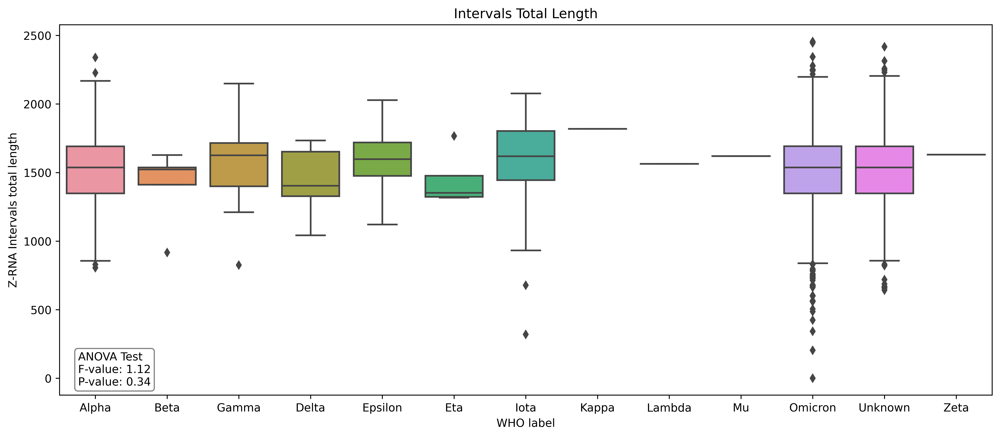

In [32]:
draw_boxplot_who(zdnabert_4K_df, values='Intervals total length', title='Intervals Total Length')

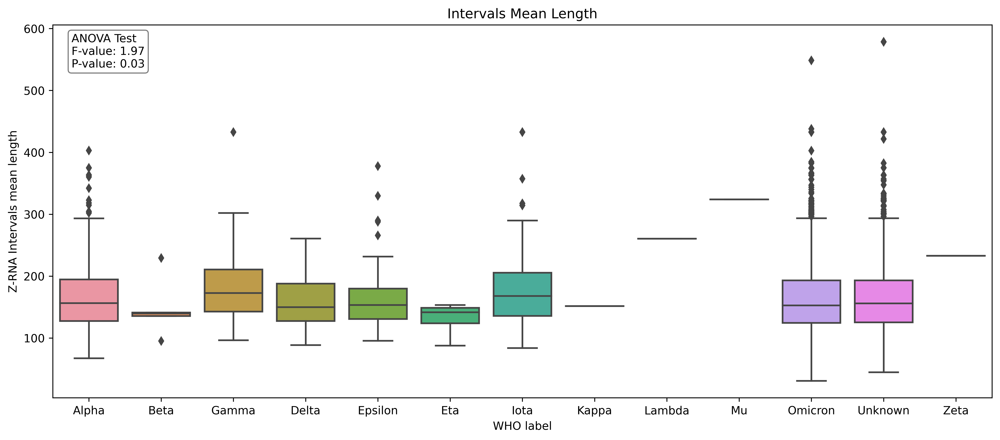

In [33]:
draw_boxplot_who(zdnabert_4K_df, values='Intervals mean length', title='Intervals Mean Length', pos=(0.02, 0.88))

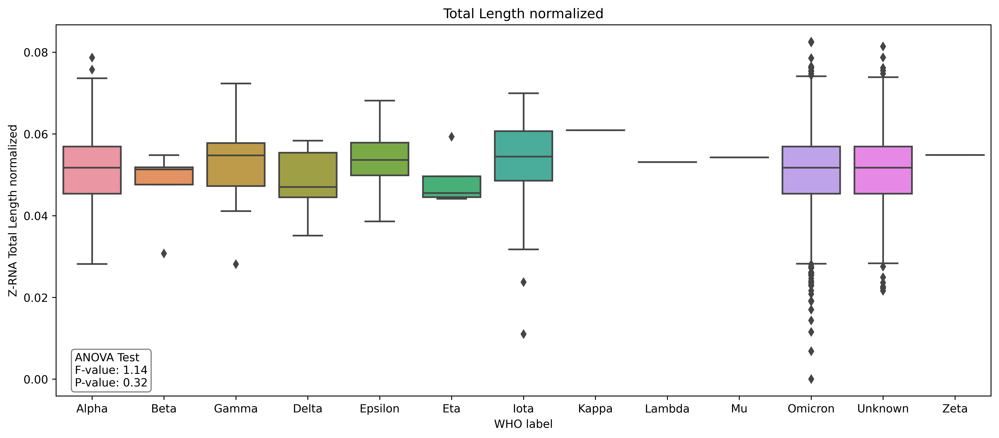

In [34]:
draw_boxplot_who(zdnabert_4K_df, values='Total Length normalized', title='Total Length normalized')

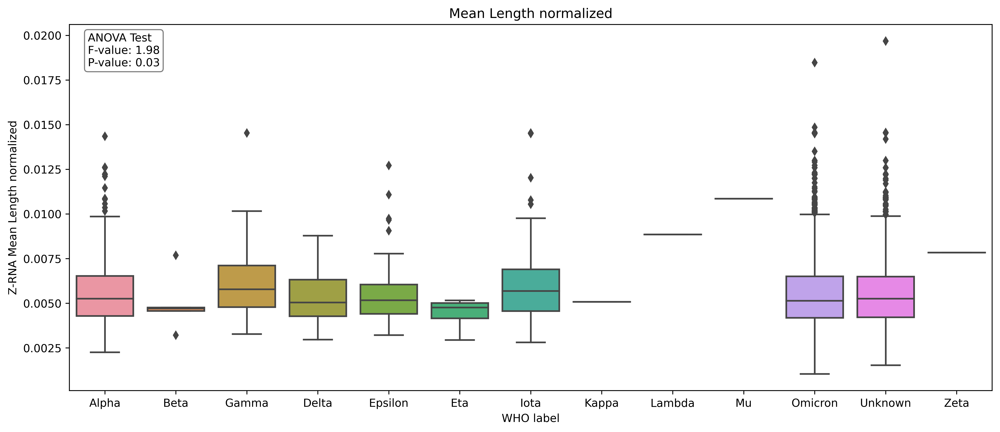

In [35]:
draw_boxplot_who(zdnabert_4K_df, values='Mean Length normalized', title='Mean Length normalized', pos=(0.02, 0.88))

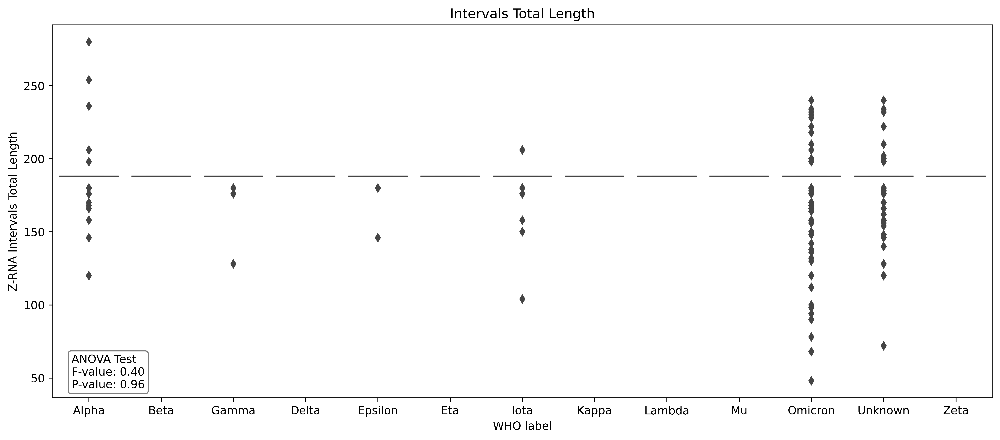

In [36]:
draw_boxplot_who(zhunt_4K_df, values='Intervals Total Length', title='Intervals Total Length')

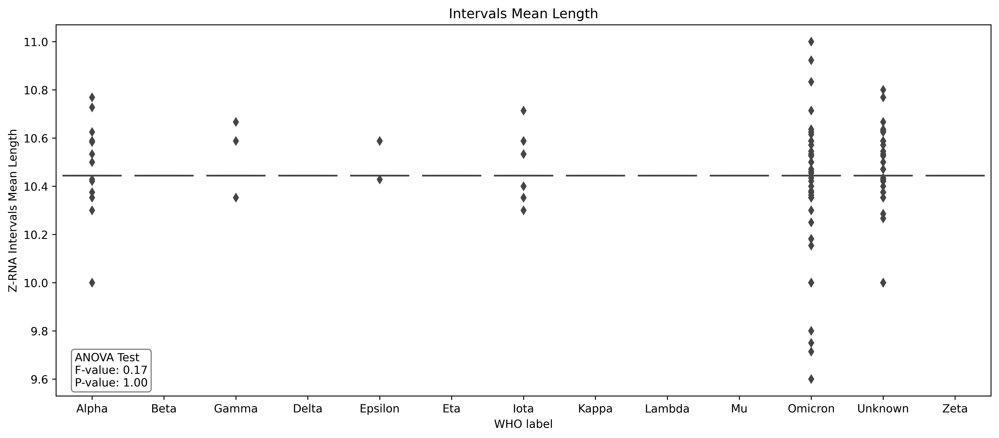

In [37]:
draw_boxplot_who(zhunt_4K_df, values='Intervals Mean Length', title='Intervals Mean Length')

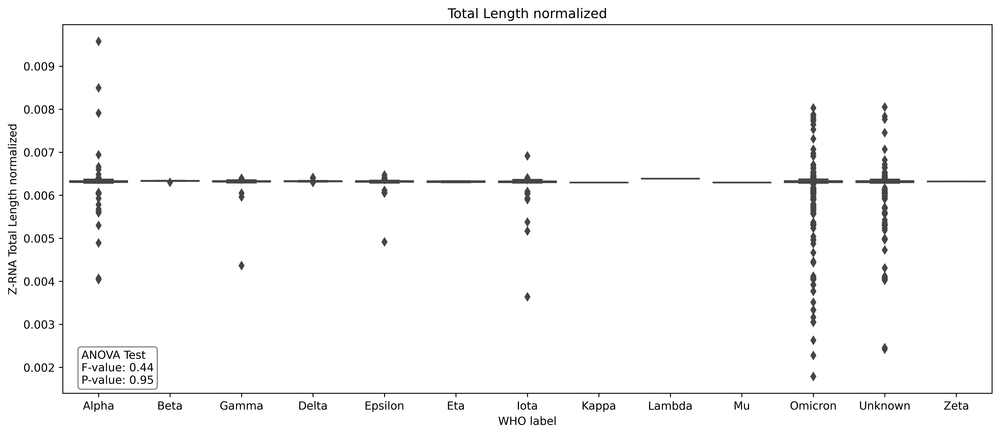

In [38]:
draw_boxplot_who(zhunt_4K_df, values='Total Length normalized', title='Total Length normalized')

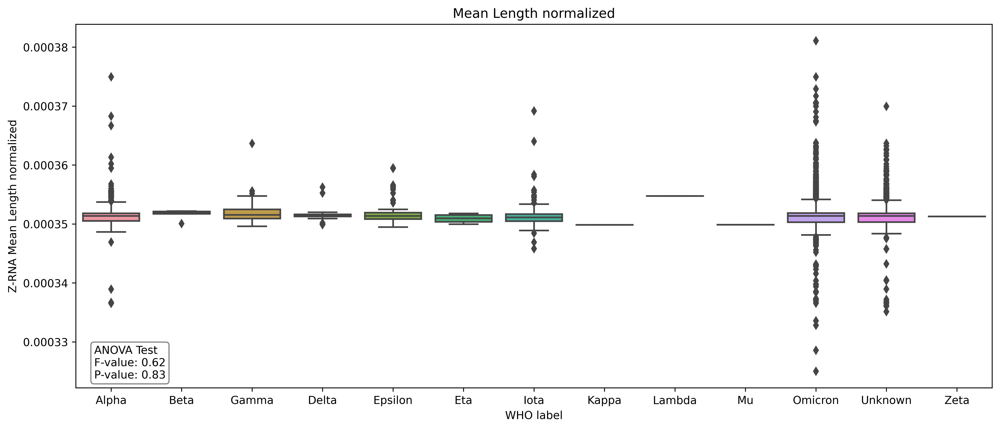

In [39]:
draw_boxplot_who(zhunt_4K_df, values='Mean Length normalized', title='Mean Length normalized')

In [40]:
zdnabert_4K_df.columns = ['Unnamed: 0', 'GenBank ID', 'Accession', 'Description',
       'Collection Date', 'Geographic Location', 'Sequence Length', 'Host',
       'Intervals Total Length', 'Intervals Mean Length', 'Pangolin',
       'WHO label', 'Total Length normalized', 'Mean Length normalized']

In [41]:
def plot_time_length_regression_linages(
    meta_df: pd.DataFrame,
    title: str = 'Time and ZNA length regression',
    remove_outliers: Tuple[bool, int] = (False, 3),
    figsize: Tuple[int, int] = (10, 5),
    point_size: int = 3,
    save_figure: bool = False,
    normalize: bool = False,
    file_name: str = 'results',
    legend_loc: str = 'best',
    close_figure: bool = False
) -> None:
    """
    Plot a time-length regression of Z-RNA regions' length against the collection date for different lineages.

    Parameters:
    meta_df (pd.DataFrame): The dataframe containing the data to be plotted.
    title (str, optional): The title of the plot. Defaults to 'Time and ZNA length regression'.
    remove_outliers (Tuple[bool, int], optional): A tuple indicating whether to remove outliers and the z-score threshold for outlier removal. Defaults to (False, 3).
    figsize (Tuple[int, int], optional): The size of the figure. Defaults to (10, 5).
    point_size (int, optional): The size of the points in the scatter plot. Defaults to 3.
    save_figure (bool, optional): Whether to save the figure as a PNG. Defaults to False.
    normalize (bool, optional): Whether to normalize the data. Defaults to False.
    file_name (str, optional): The name of the file to save the figure as. Defaults to 'results'.
    legend_loc (str, optional): The location of the legend. Defaults to 'best'.
    close_figure (bool, optional): Whether to close the figure after plotting. Defaults to False.

    Returns:
    None
    """

    # Copy the dataframe
    df_copy = meta_df.copy()

    # Normalize the data if specified
    if normalize:
        df_copy['Normalized_Length'] = df_copy['Intervals Total Length'] / df_copy['Sequence Length']
        length_column = 'Normalized_Length'
    else:
        length_column = 'Intervals Total Length'

    # Convert the collection date to datetime and ordinal
    df_copy['Collection_Date'] = pd.to_datetime(df_copy['Collection Date'], errors='coerce')
    df_copy = df_copy.dropna(subset=['Collection_Date'])
    df_copy['Date_Ordinal'] = df_copy['Collection_Date'].apply(lambda x: x.toordinal())

    # Remove outliers if specified
    if remove_outliers[0]:
        z_scores = df_copy[['Date_Ordinal', 'Intervals Total Length']].apply(lambda x: (x - x.mean()) / x.std())
        df_copy = df_copy[(np.abs(z_scores['Date_Ordinal']) <= remove_outliers[1]) & (np.abs(z_scores['Intervals Total Length']) <= remove_outliers[1])]

    # Create a color map
    color_map = {
    'Unknown': '#1f77b4',  # muted blue
    'Omicron': '#ff7f0e',  # safety orange
    'Gamma': '#2ca02c',  # cooked asparagus green
    'Delta': '#d62728',  # brick red
    'Alpha': '#9467bd',  # muted purple
    'Epsilon': '#8c564b',  # chestnut brown
    'Eta': '#e377c2',  # raspberry yogurt pink
    'Iota': '#7f7f7f',  # middle gray
    'Mu': '#bcbd22',  # curry yellow-green
    'Beta': '#17becf',  # blue-teal
    'Kappa': '#ff9896',  # light pink
    'Zeta': '#c5b0d5',  # light purple
    'Lambda': '#c49c94'  # light brown
    }

    # Fit a linear regression model
    X = df_copy[['Date_Ordinal']]
    y = df_copy[length_column]
    regression_model = LinearRegression()
    regression_model.fit(X, y)
    y_pred = regression_model.predict(X)

    # Create the figure
    plt.figure(figsize=figsize)

    # Plot the data points for each cluster
    for linage in set(df_copy['WHO label']):
        plt.scatter(df_copy[df_copy['WHO label'] == linage]['Collection_Date'],
                    df_copy[df_copy['WHO label'] == linage][length_column],
                    color=color_map[linage], label=f"{linage}", s=point_size)

    # Plot the regression line
    plt.plot(df_copy['Collection_Date'], y_pred, color='red', label='Regression Line')

    # Get the slope and intercept of the regression line
    slope = regression_model.coef_[0]
    intercept = regression_model.intercept_

    # Create a list of legend elements
    legend_elements = [Line2D([0], [0], marker='o', color='w', label=f"{linage}", markerfacecolor=color, markersize=10)
                       for linage, color in color_map.items()]
    legend_elements.append(Line2D([0], [0], color='red', lw=2, label='Regression Line'))
    legend_elements.append(Line2D([0], [0], marker='None', color='w', label=f"Slope = {slope:.2f}\nIntercept = {intercept:.2f}"))

    # Customize the plot
    plt.legend(handles=legend_elements, loc=legend_loc, framealpha=0.5)
    plt.grid(visible=True, which='major', axis='both', linestyle='-')
    plt.title(title)
    plt.xlabel('Collection Date')
    plt.ylabel('Z-RNA Regions Length')

    # Save the figure if specified
    if save_figure:
        plt.savefig(f"{file_name}_heatmap.png")
        plt.savefig(f"{file_name}_heatmap.pdf")

    # Close the figure if specified
    if close_figure:
        plt.close()

    # Show the plot
    plt.show()

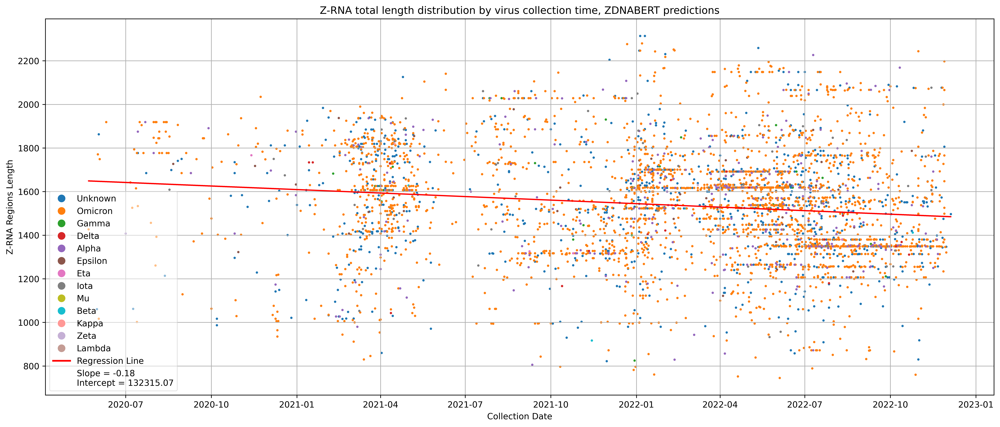

In [42]:
plot_time_length_regression_linages(zdnabert_4K_df,
                                    title='Z-RNA total length distribution by virus collection time, ZDNABERT predictions',
                                    figsize=(20, 8), remove_outliers=(True, 3))

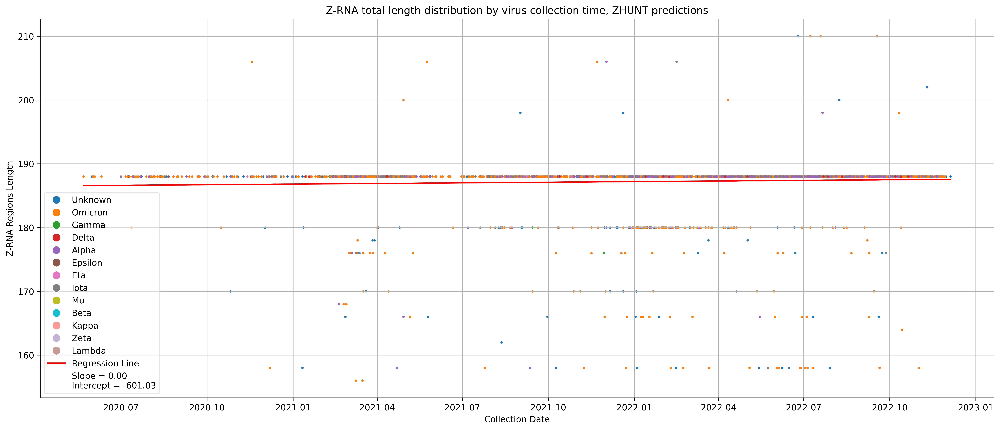

In [43]:
plot_time_length_regression_linages(zhunt_4K_df,
                                    title='Z-RNA total length distribution by virus collection time, ZHUNT predictions',
                                    figsize=(20, 8), remove_outliers=(True, 3))

In [44]:
def plot_time_length_linages_boxplot(
    meta_df: pd.DataFrame,
    title: str = 'Time and ZNA length regression',
    remove_outliers: Tuple[bool, int] = (False, 3),
    figsize: Tuple[int, int] = (14, 8),
    text_position: Tuple[float, float] = (0.01, 0.90),
    save_figure: bool = False,
    normalize: bool = False,
    file_name: str = 'results',
    legend_loc: str = 'best',
    close_figure: bool = False
) -> None:

    # Copy the dataframe
    df_copy = meta_df.copy()

    # Normalize the data if specified
    if normalize:
        df_copy['Normalized_Length'] = df_copy['Intervals Total Length'] / df_copy['Sequence Length']
        length_column = 'Normalized_Length'
    else:
        length_column = 'Intervals Total Length'

    # Convert the collection date to datetime and extract year and month
    df_copy['Collection_Date'] = pd.to_datetime(df_copy['Collection Date'], errors='coerce')
    df_copy['Year_Month'] = df_copy['Collection_Date'].dt.to_period('M')

    # Order by year and month
    df_copy['Year_Month'] = df_copy['Year_Month'].astype(CategoricalDtype(categories=sorted(df_copy['Year_Month'].unique()), ordered=True))

    # Remove outliers if specified
    if remove_outliers[0]:
        z_scores = df_copy[[length_column]].apply(lambda x: (x - x.mean()) / x.std())
        df_copy = df_copy[(np.abs(z_scores[length_column]) <= remove_outliers[1])]

    # Create the figure
    fig, ax = plt.subplots(figsize=figsize)

    # Plot the boxplot for each month using seaborn
    sns.boxplot(x="Year_Month", y=length_column, data=df_copy, palette='viridis', width=0.5, ax=ax)

    # Perform ANOVA
    groups = [group[length_column].dropna() for name, group in df_copy.groupby('Year_Month')]
    f_value, p_value = stats.f_oneway(*groups)

    # Add the F-value, p-value, and test name inside the plot
    anova_text = f'ANOVA Test\nF-value: {f_value:.2f}\nP-value: {p_value:.4f}'
    ax.text(
        *text_position, anova_text, transform=ax.transAxes, fontsize=10,
        verticalalignment='bottom', bbox=dict(boxstyle='round', facecolor='white', alpha=0.5)
    )

    # Customize the plot
    ax.set_title(title, fontsize=16)
    ax.set_xlabel('Collection Date', fontsize=14)
    ax.set_ylabel('Z-RNA Regions Length', fontsize=14)
    plt.xticks(rotation=90, fontsize=10)

    # Save the figure if specified
    if save_figure:
        plt.savefig(f"{file_name}_boxplot.png", dpi=300)
        plt.savefig(f"{file_name}_boxplot.pdf", dpi=300)

    # Close the figure if specified
    if close_figure:
        plt.close()

    # Show the plot
    plt.show()


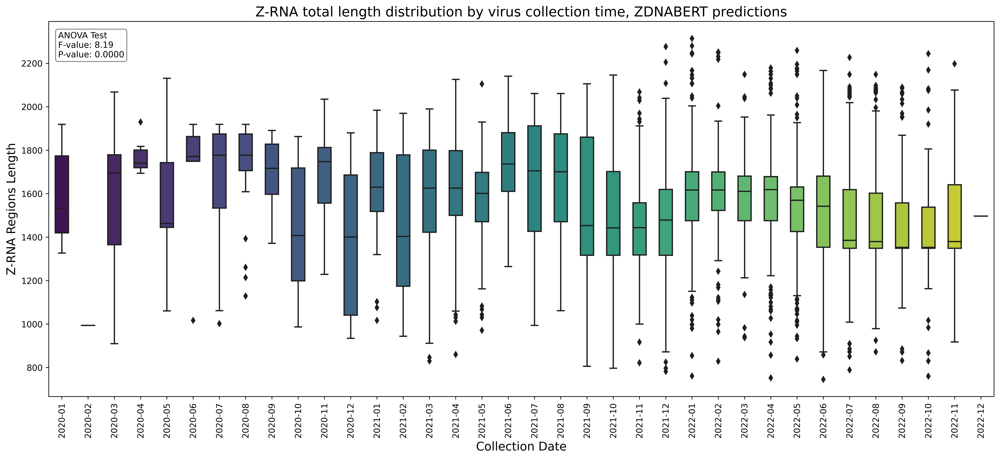

In [45]:
plot_time_length_linages_boxplot(zdnabert_4K_df,
                                    title='Z-RNA total length distribution by virus collection time, ZDNABERT predictions',
                                    figsize=(20, 8), remove_outliers=(True, 3))

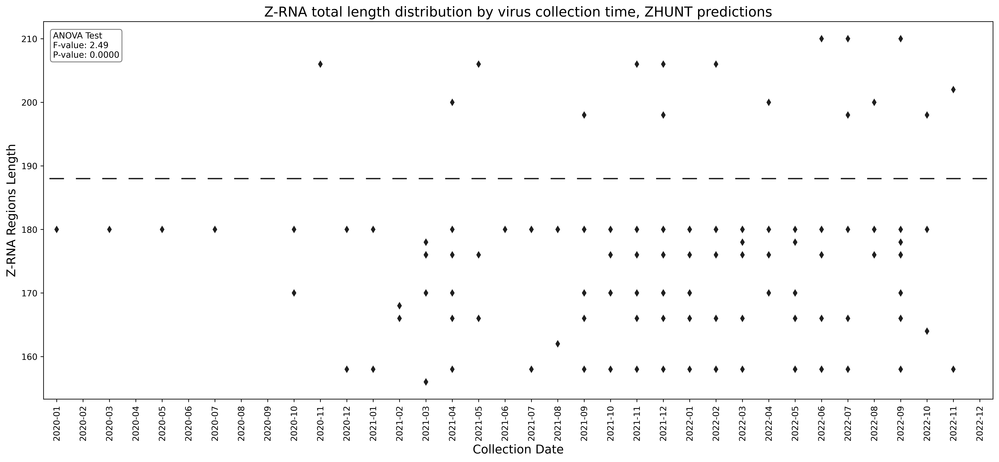

In [46]:
plot_time_length_linages_boxplot(zhunt_4K_df,
                                    title='Z-RNA total length distribution by virus collection time, ZHUNT predictions',
                                    figsize=(20, 8), remove_outliers=(True, 3))

In [47]:
def create_clustered_dataframe(intervals_dict: Dict, virus_name: str) -> Tuple[pd.DataFrame, np.ndarray, int]:
    """
    This function creates a clustered dataframe based on Jaccard indices of intervals.

    Parameters:
    intervals_dict: Dictionary containing Z-RNA interval data.
    virus_name (str): The name of the virus.
    dataframe_subset (pd.DataFrame): The subset of the dataframe to be clustered.

    Returns:
    clustered_dataframe (pd.DataFrame): The clustered dataframe.
    row_linkage_matrix (np.ndarray): The hierarchical clustering encoded as a linkage matrix.
    optimal_color_threshold (int): The optimal color threshold for the clusters.
    """

    # Parse the intervals file
    sequence_ids = list(intervals_dict.keys())

    # Check if there are enough sequences
    if len(sequence_ids) < 5:
        return 'Less than 5 sequences'

    # Compute the Jaccard index matrix
    intervals_list = list(intervals_dict.items())
    interval_count = len(intervals_list)
    sequence_labels = [intervals_list[i][0] for i in range(interval_count)]
    jaccard_index_matrix = [[compute_jaccard_index(intervals_list[i][1], intervals_list[j][1]) for j in range(interval_count)] for i in range(interval_count)]
    jaccard_dataframe = pd.DataFrame(jaccard_index_matrix, index=sequence_labels, columns=sequence_labels)

    # Perform hierarchical clustering on rows and columns
    row_linkage_matrix = linkage(jaccard_dataframe.values, method='average', metric='euclidean')
    column_linkage_matrix = linkage(jaccard_dataframe.values.T, method='average', metric='euclidean')

    # Reorder the dataframe based on the clustering
    row_dendrogram = dendrogram(row_linkage_matrix, no_plot=True)
    column_dendrogram = dendrogram(column_linkage_matrix, no_plot=True)
    clustered_dataframe = jaccard_dataframe.iloc[row_dendrogram['leaves'], column_dendrogram['leaves']]

    # Find the optimal color threshold for the clusters
    max_cluster_count = -1
    optimal_color_threshold = -1
    for color_threshold in range(2, 7):
        cluster_index = fcluster(row_linkage_matrix, t=color_threshold, criterion='distance')
        cluster_count = len(set(cluster_index))
        if cluster_count <= 10 and cluster_count > max_cluster_count:
            max_cluster_count = cluster_count
            optimal_color_threshold = color_threshold

    return clustered_dataframe, row_linkage_matrix, optimal_color_threshold

In [48]:
def plot_time_length_regression(meta_df: pd.DataFrame, clusterd_df: pd.DataFrame, row_linkage: np.ndarray, color_threshold: float,
                                title: str = 'Time and ZNA length regression',
                                remove_outliers: Tuple[bool, int] = (True, 3),
                                figsize: Tuple[int, int] = (10, 5), point_size: int = 20,
                                save_figure: bool = False, normalize: bool = False, file_name: str = 'results',
                                legend_loc: str = 'best', close_figure: bool = False) -> None:
    """
    This function plots a time-length regression.

    Parameters:
    df (pd.DataFrame): The dataframe to be plotted.
    row_linkage (np.ndarray): The hierarchical clustering encoded as a linkage matrix.
    color_threshold (float): The color threshold for the dendrogram.
    title (str): The title of the plot.
    remove_outliers (Tuple[bool, int]): A tuple indicating whether to remove outliers and the z-score threshold for outlier removal.
    figsize (Tuple[int, int]): The size of the figure.
    point_size (int): The size of the points in the scatter plot.
    save_figure (bool): Whether to save the figure as a PNG.
    normalize (bool): Whether to normalize the data.
    file_name (str): The name of the file to save the figure as.
    legend_loc (str): The location of the legend.
    off (bool): Whether to close the figure after plotting.

    Returns:
    None
    """

    # Copy the dataframe
    clusterd_ids = clusterd_df.columns
    clusterd_ids_dict = {k: v for v, k in enumerate(clusterd_ids)}
    df_copy = meta_df[meta_df['Accession'].isin(clusterd_ids)]
    df_copy['order'] = df_copy['Accession'].apply(clusterd_ids_dict.get)
    df_copy = df_copy.sort_values('order').drop(columns='order')


    # Normalize the data if specified
    if normalize:
        df_copy['Normalized_Length'] = df_copy['Intervals Total Length'] / df_copy.loc[df_copy['Accession'].isin(df_copy['Accession']), 'Sequence Length']
        length_column = 'Normalized_Length'
    else:
        length_column = 'Intervals Total Length'

    # Assign each data point to a cluster
    df_copy['Clusters'] = fcluster(row_linkage, t=color_threshold, criterion='distance')

    # Convert the collection date to datetime and ordinal
    df_copy['Collection_Date'] = pd.to_datetime(df_copy['Collection Date'], errors='coerce')
    df_copy = df_copy.dropna(subset=['Collection_Date'])
    df_copy['Date_Ordinal'] = df_copy['Collection_Date'].apply(lambda x: x.toordinal())

    # Remove outliers if specified
    if remove_outliers[0]:
        z_scores = df_copy[['Date_Ordinal', 'Intervals Total Length']].apply(lambda x: (x - x.mean()) / x.std())
        df_copy = df_copy[(np.abs(z_scores['Date_Ordinal']) <= remove_outliers[1]) & (np.abs(z_scores['Intervals Total Length']) <= remove_outliers[1])]

    # Create a color map
    color_map = {
        1: "#ff7f0e",
        2: "#2ca02c",
        3: "#d62728",
        4: "#9467bd",
        5: "#8c564b",
        6: "#e377c2",
        7: "#7f7f7f",
        8: "#bcbd22",
        9: "#17becf",
        10: "#1f77b4",
    }

    # Fit a linear regression model
    X = df_copy[['Date_Ordinal']]
    y = df_copy[length_column]
    regression_model = LinearRegression()
    regression_model.fit(X, y)
    y_pred = regression_model.predict(X)

    # Create the figure
    plt.figure(figsize=figsize)

    # Plot the data points for each cluster
    for cluster in set(df_copy['Clusters']):
        plt.scatter(df_copy[df_copy['Clusters'] == cluster]['Collection_Date'],
                    df_copy[df_copy['Clusters'] == cluster][length_column],
                    color=color_map[cluster], label=f"Cluster: {cluster}", s=point_size)

    # Plot the regression line
    plt.plot(df_copy['Collection_Date'], y_pred, color='red', label='Regression Line')

    # Get the slope and intercept of the regression line
    slope = regression_model.coef_[0]
    intercept = regression_model.intercept_

    # Create a list of legend elements
    legend_elements = [Line2D([0], [0], marker='o', color='w', label=f"Cluster: {cluster}", markerfacecolor=color_map[cluster], markersize=10)
                       for cluster in set(df_copy['Clusters'])]
    legend_elements.append(Line2D([0], [0], color='red', lw=2, label='Regression Line'))
    legend_elements.append(Line2D([0], [0], marker='None', color='w', label=f"Slope = {slope:.2f}\nIntercept = {intercept:.2f}"))

    # Customize the plot
    plt.legend(handles=legend_elements, loc=legend_loc)
    plt.grid(visible=True, which='major', axis='both', linestyle='-')
    plt.title(title)
    plt.xlabel('Collection Date')
    plt.ylabel('Z-RNA Regions Length')

    # Save the figure if specified
    if save_figure:
        plt.savefig(f"{file_name}_heatmap.png")
        plt.savefig(f"{file_name}_heatmap.pdf")

    # Close the figure if specified
    if close_figure:
        plt.close()

    # Show the plot
    plt.show()

In [ ]:
virus = 'SARS-CoV-2'
title = 'SARS-CoV-2 (ZDNABERT)'
intervals = parse_prediction_files('/content/Coronaviridae strains_DNABERT_predictions/SARS-CoV-2-4.3K_HG_chipseq_0.2_predictions.txt')
meta = pd.read_csv("/content/Coronaviridae strains META DNABERT/df_subset_SARS-CoV-2_4.3K.csv")
meta.columns = ['Unnamed: 0', 'GenBank ID', 'Accession', 'Description',
      'Collection Date', 'Geographic Location', 'Sequence Length', 'Host',
      'Intervals Total Length', 'Intervals Mean Length']
clustered_dataframe, row_linkage_matrix, optimal_color_threshold = create_clustered_dataframe(intervals, virus_name=virus)

In [ ]:
plot_heatmap_with_dendrogram(clustered_dataframe, row_linkage_matrix, 13, title=title, figsize=(10, 10))
plot_time_length_regression(meta, clustered_dataframe, row_linkage_matrix, 13, title=title, figsize=(20, 10))

In [53]:
with open("/content/ZHUN_4.3K.json", 'r') as json_file:
    data_dict = json.load(json_file)

In [54]:
virus = 'SARS-CoV-2'
title = 'SARS-CoV-2 (ZHUNT)'
intervals = data_dict
meta = pd.read_csv('/content/Coronaviridae strains META ZHUNT/ZHUNT_df_subset_SARS-CoV-2_4.3K.csv')
meta.columns = ['Unnamed: 0', 'GenBank ID', 'Accession', 'Description',
      'Collection Date', 'Geographic Location', 'Sequence Length', 'Host',
      'Intervals Total Length', 'Intervals Mean Length']
clustered_dataframe, row_linkage_matrix, optimal_color_threshold = create_clustered_dataframe(intervals, virus_name=virus)

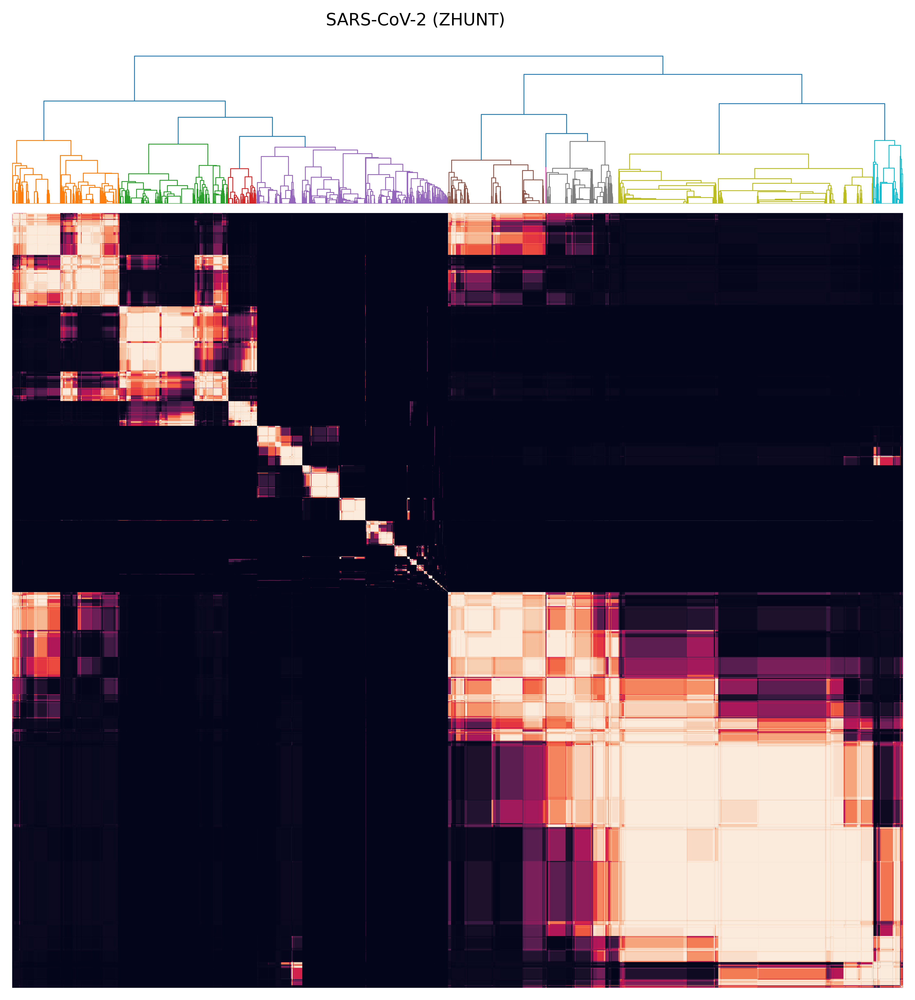

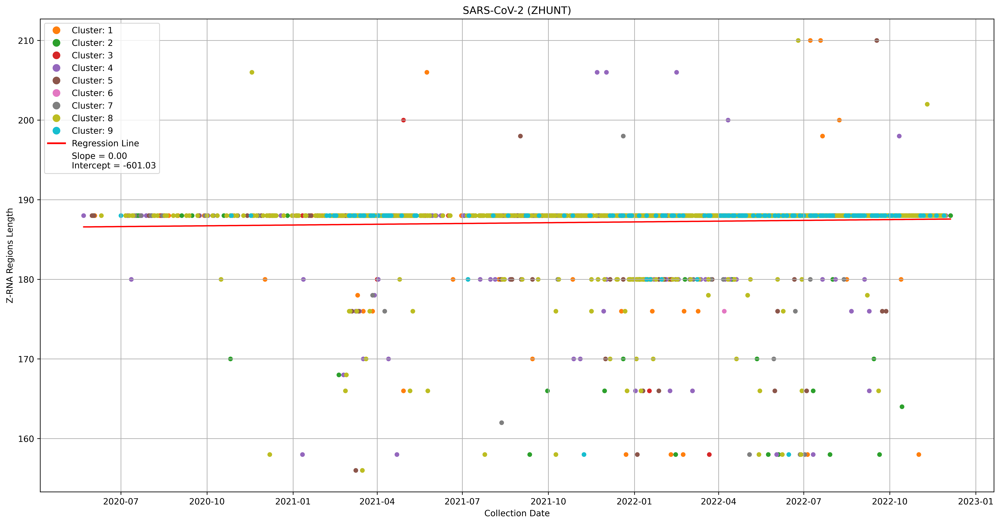

In [58]:
plot_heatmap_with_dendrogram(clustered_dataframe, row_linkage_matrix, 16, title=title, figsize=(10, 10))
plot_time_length_regression(meta, clustered_dataframe, row_linkage_matrix, 16, title=title, figsize=(20, 10))

In [ ]:
zhunt_zrna_files = sorted(glob.glob('/content/Coronaviridae strains_ZHUNT_predictions/*'))
zhunt_zrna_meta = sorted(glob.glob('/content/Coronaviridae strains META ZHUNT/*'))
pairs_zhunt = list(zip(zhunt_zrna_files, zhunt_zrna_meta))

In [ ]:
zdnabert_zrna_files = sorted(glob.glob('/content/Coronaviridae strains_DNABERT_predictions/*'))
zdnabert_zrna_meta = sorted(glob.glob('/content/Coronaviridae strains META DNABERT/*'))
pairs_zdnabert = list(zip(zdnabert_zrna_files, zdnabert_zrna_meta))

In [ ]:
pairs_zhunt_selected = [('/content/Coronaviridae strains_ZHUNT_predictions/ZHUNT_Severe acute respiratory syndrome-related coronavirus.txt',
                         '/content/Coronaviridae strains META ZHUNT/ZHUNT_df_subset_Severe acute respiratory syndrome-related coronavirus.csv'),
                        ('/content/Coronaviridae strains_ZHUNT_predictions/ZHUNT_Middle East respiratory syndrome-related coronavirus.txt',
                         '/content/Coronaviridae strains META ZHUNT/ZHUNT_df_subset_Middle East respiratory syndrome-related coronavirus.csv'),
                        ('/content/Coronaviridae strains_ZHUNT_predictions/ZHUNT_Human coronavirus 229E.txt',
                         '/content/Coronaviridae strains META ZHUNT/ZHUNT_df_subset_Human coronavirus 229E.csv'),
                        ('/content/Coronaviridae strains_ZHUNT_predictions/ZHUNT_Human coronavirus HKU1.txt',
                         '/content/Coronaviridae strains META ZHUNT/ZHUNT_df_subset_Human coronavirus HKU1.csv'),
                        ('/content/Coronaviridae strains_ZHUNT_predictions/ZHUNT_Human coronavirus NL63.txt',
                         '/content/Coronaviridae strains META ZHUNT/ZHUNT_df_subset_Human coronavirus NL63.csv'),
                        ('/content/Coronaviridae strains_ZHUNT_predictions/ZHUNT_Bat coronavirus HKU10.txt',
                         '/content/Coronaviridae strains META ZHUNT/ZHUNT_df_subset_Bat coronavirus HKU10.csv'),
                        ('/content/Coronaviridae strains_ZHUNT_predictions/ZHUNT_Alphacoronavirus AMALF.txt',
                         '/content/Coronaviridae strains META ZHUNT/ZHUNT_df_subset_Alphacoronavirus AMALF.csv'),
                        ('/content/Coronaviridae strains_ZHUNT_predictions/ZHUNT_Avian coronavirus.txt',
                         '/content/Coronaviridae strains META ZHUNT/ZHUNT_df_subset_Avian coronavirus.csv'),
                        ('/content/Coronaviridae strains_ZHUNT_predictions/ZHUNT_Murine coronavirus.txt',
                         '/content/Coronaviridae strains META ZHUNT/ZHUNT_df_subset_Murine coronavirus.csv'),
                        ('/content/Coronaviridae strains_ZHUNT_predictions/ZHUNT_Betacoronavirus 1.txt',
                         '/content/Coronaviridae strains META ZHUNT/ZHUNT_df_subset_Betacoronavirus 1.csv'),
                        ('/content/Coronaviridae strains_ZHUNT_predictions/ZHUNT_Porcine epidemic diarrhea virus.txt',
                         '/content/Coronaviridae strains META ZHUNT/ZHUNT_df_subset_Porcine epidemic diarrhea virus.csv'),
                        ]

In [ ]:
pairs_zdnabert_selected = [('/content/Coronaviridae strains_DNABERT_predictions/Severe acute respiratory syndrome-related coronavirus.fastext_predictions.txt',
                            '/content/Coronaviridae strains META DNABERT/df_subset_SARS.csv'),
                           ('/content/Coronaviridae strains_DNABERT_predictions/Middle East respiratory syndrome-related coronavirus.fastext_predictions.txt',
                            '/content/Coronaviridae strains META DNABERT/df_subset_MERS.csv'),
                           ('/content/Coronaviridae strains_DNABERT_predictions/Human coronavirus 229E.fastext_predictions.txt',
                            '/content/Coronaviridae strains META DNABERT/df_subset_Human coronavirus 229E.csv'),
                           ('/content/Coronaviridae strains_DNABERT_predictions/Human coronavirus HKU1.fastext_predictions.txt',
                            '/content/Coronaviridae strains META DNABERT/df_subset_Human coronavirus HKU1.csv'),
                           ('/content/Coronaviridae strains_DNABERT_predictions/Human coronavirus NL63.fastext_predictions.txt',
                            '/content/Coronaviridae strains META DNABERT/df_subset_Human coronavirus NL63.csv'),
                           ('/content/Coronaviridae strains_DNABERT_predictions/Bat coronavirus HKU10.fastext_predictions.txt',
                            '/content/Coronaviridae strains META DNABERT/df_subset_Bat coronavirus HKU10.csv'),
                           ('/content/Coronaviridae strains_DNABERT_predictions/Alphacoronavirus AMALF.fastext_predictions.txt',
                            '/content/Coronaviridae strains META DNABERT/df_subset_Alphacoronavirus AMALF.csv'),
                           ('/content/Coronaviridae strains_DNABERT_predictions/Avian coronavirus.fastext_predictions.txt',
                            '/content/Coronaviridae strains META DNABERT/df_subset_Avian coronavirus.csv'),
                           ('/content/Coronaviridae strains_DNABERT_predictions/Murine coronavirus.fastext_predictions.txt',
                            '/content/Coronaviridae strains META DNABERT/df_subset_Murine coronavirus.csv'),
                           ('/content/Coronaviridae strains_DNABERT_predictions/Betacoronavirus 1.fastext_predictions.txt',
                            '/content/Coronaviridae strains META DNABERT/df_subset_Betacoronavirus 1.csv'),
                          #  ('/content/Coronaviridae strains_DNABERT_predictions/Porcine epidemic diarrhea virus.fastext_predictions.txt',
                          #   '/content/Coronaviridae strains META DNABERT/df_subset_Porcine epidemic diarrhea virus.csv'),
                        ]

In [ ]:
for intervals, meta in pairs_zdnabert_selected:
  virus = re.split(r'[/;.]', intervals)[3]
  intervals = parse_prediction_files(intervals)
  title=f"{virus} strains (ZDNABERT)"
  meta = pd.read_csv(meta)
  meta.columns = ['Unnamed: 0', 'GenBank ID', 'Accession', 'Description',
       'Collection Date', 'Geographic Location', 'Sequence Length', 'Host',
       'Intervals Total Length', 'Intervals Mean Length']
  try:
    clustered_dataframe, row_linkage_matrix, optimal_color_threshold = create_clustered_dataframe(intervals, virus_name=virus)
  except ValueError:
    continue
  plot_heatmap_with_dendrogram(clustered_dataframe, row_linkage_matrix, optimal_color_threshold, title=title, figsize=(10, 10))
  plot_time_length_regression(meta, clustered_dataframe, row_linkage_matrix, optimal_color_threshold, title=title, figsize=(15, 10))

In [ ]:
for intervals, meta in pairs_zhunt_selected:
  virus = re.split(r'[_;.]', intervals)[3]
  intervals = parse_prediction_files(intervals)
  title=f"{virus} strains (ZHUNT)"
  meta = pd.read_csv(meta)
  meta.columns = ['Unnamed: 0', 'GenBank ID', 'Accession', 'Description',
       'Collection Date', 'Geographic Location', 'Sequence Length', 'Host',
       'Intervals Total Length', 'Intervals Mean Length']
  try:
    clustered_dataframe, row_linkage_matrix, optimal_color_threshold = create_clustered_dataframe(intervals, virus_name=virus)
  except ValueError:
    continue
  plot_heatmap_with_dendrogram(clustered_dataframe, row_linkage_matrix, optimal_color_threshold, title=title, figsize=(10, 10))
  plot_time_length_regression(meta, clustered_dataframe, row_linkage_matrix, optimal_color_threshold, title=title, figsize=(15, 10))

In [ ]:
pairs_zhunt_selected[-1]

In [ ]:
for intervals, meta in [pairs_zhunt_selected[-1]:
  virus = re.split(r'[_;.]', intervals)[3]
  intervals = parse_prediction_files(intervals)
  title=f"{virus} strains (ZHUNT)"
  meta = pd.read_csv(meta)
  meta.columns = ['Unnamed: 0', 'GenBank ID', 'Accession', 'Description',
       'Collection Date', 'Geographic Location', 'Sequence Length', 'Host',
       'Intervals Total Length', 'Intervals Mean Length']
  try:
    clustered_dataframe, row_linkage_matrix, optimal_color_threshold = create_clustered_dataframe(intervals, virus_name=virus)
  except ValueError:
    continue

In [ ]:
plot_heatmap_with_dendrogram(clustered_dataframe, row_linkage_matrix, 10, title=title, figsize=(10, 10))
plot_time_length_regression(meta, clustered_dataframe, row_linkage_matrix, 10, title=title, figsize=(15, 10))